## 1. Import Packages

In [2]:
!pip install ultralytics opencv-python pillow matplotlib --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.9/914.9 kB 32.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 109.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 72.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 96.1 MB/s eta 0:00:00


In [3]:
from ultralytics import YOLO
import torch
import matplotlib.pyplot as plt
import cv2

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## 2. Train the Model

In [4]:
model = YOLO("yolov8n.pt")

100%|██████████| 6.25M/6.25M [00:00<00:00, 95.5MB/s]


In [5]:
dataset_yaml = "Dataset/dataset.yaml"

In [6]:
results = model.train(data=dataset_yaml, epochs=100, batch=16, imgsz=640, device="cuda")

Ultralytics 8.3.71 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/Bondstein/Dataset/dataset.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

100%|██████████| 755k/755k [00:00<00:00, 18.7MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 96.1MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/.shortcut-targets-by-id/1ssI0mo9gAtWxW2SBTpMNlG7opQnFbFDh/Bondstein/Dataset/labels/train... 128 images, 0 backgrounds, 0 corrupt: 100%|██████████| 128/128 [01:09<00:00,  1.85it/s]

train: New cache created: /content/drive/.shortcut-targets-by-id/1ssI0mo9gAtWxW2SBTpMNlG7opQnFbFDh/Bondstein/Dataset/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.3 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/.shortcut-targets-by-id/1ssI0mo9gAtWxW2SBTpMNlG7opQnFbFDh/Bondstein/Dataset/labels/val... 32 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32/32 [00:30<00:00,  1.04it/s]

val: New cache created: /content/drive/.shortcut-targets-by-id/1ssI0mo9gAtWxW2SBTpMNlG7opQnFbFDh/Bondstein/Dataset/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.26G      1.302      3.722     0.9682        178        640: 100%|██████████| 8/8 [00:10<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.93s/it]

                   all         32        156     0.0111      0.654      0.336      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.18G      1.224      2.256     0.9047        183        640: 100%|██████████| 8/8 [00:03<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.28it/s]

                   all         32        156     0.0139      0.904      0.438      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.21G      1.191       1.33     0.9183        205        640: 100%|██████████| 8/8 [00:05<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         32        156          1      0.208      0.569      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.18G       1.15      1.138     0.9396        158        640: 100%|██████████| 8/8 [00:02<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.91it/s]

                   all         32        156          1      0.122      0.553      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.18G      1.165      1.053     0.9503        154        640: 100%|██████████| 8/8 [00:02<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         32        156     0.0156      0.941       0.67      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       2.2G       1.12      0.964     0.9275        181        640: 100%|██████████| 8/8 [00:02<00:00,  2.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.23it/s]

                   all         32        156     0.0159      0.997      0.726      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       2.2G      1.082     0.8665     0.9249        174        640: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.80it/s]

                   all         32        156     0.0159      0.997      0.879      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.22G      1.077     0.8409     0.9293        173        640: 100%|██████████| 8/8 [00:02<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.82it/s]

                   all         32        156     0.0157      0.997      0.951      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.21G      1.052      0.822     0.9283        156        640: 100%|██████████| 8/8 [00:02<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         32        156      0.978      0.182      0.954      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.19G      1.069     0.7998      0.917        188        640: 100%|██████████| 8/8 [00:03<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.04s/it]

                   all         32        156      0.982      0.369      0.967      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.18G      1.083     0.7952     0.9139        184        640: 100%|██████████| 8/8 [00:02<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all         32        156      0.945      0.815      0.976      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.23G      1.097     0.7731     0.9315        161        640: 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         32        156      0.938      0.965      0.967      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.18G       1.05     0.7592     0.9358        138        640: 100%|██████████| 8/8 [00:02<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         32        156      0.934      0.988      0.973      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       2.2G      1.048     0.7322     0.9071        222        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.27it/s]

                   all         32        156      0.934      0.982      0.974      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.18G      1.053     0.7429      0.922        155        640: 100%|██████████| 8/8 [00:02<00:00,  3.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.77it/s]

                   all         32        156       0.93      0.978      0.978      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.21G      1.044     0.7135     0.9185        171        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all         32        156      0.944      0.991      0.984       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.23G       1.02     0.7085     0.9069        162        640: 100%|██████████| 8/8 [00:03<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         32        156      0.929      0.994       0.97      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.21G      1.016     0.7087     0.9129        184        640: 100%|██████████| 8/8 [00:02<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         32        156      0.949      0.994      0.972      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.22G     0.9976     0.7207      0.922        149        640: 100%|██████████| 8/8 [00:02<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         32        156       0.95      0.994      0.979      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.18G      1.025     0.7031     0.9048        170        640: 100%|██████████| 8/8 [00:02<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         32        156      0.925      0.992      0.979      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.21G     0.9914     0.6868     0.8936        193        640: 100%|██████████| 8/8 [00:03<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         32        156      0.948      0.994      0.981      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.19G     0.9924     0.6649     0.8976        181        640: 100%|██████████| 8/8 [00:02<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]

                   all         32        156      0.933          1      0.981      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.21G      1.003     0.6494     0.8955        161        640: 100%|██████████| 8/8 [00:02<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.47it/s]

                   all         32        156      0.925      0.997      0.984      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.19G     0.9704     0.6494     0.9042        183        640: 100%|██████████| 8/8 [00:02<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         32        156      0.946      0.995       0.98      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.16G      1.002     0.6572     0.8982        144        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.21it/s]

                   all         32        156      0.926      0.991      0.979      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.18G     0.9908     0.6527     0.9044        190        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.72it/s]

                   all         32        156      0.928      0.989      0.975      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100       2.2G     0.9655     0.6194     0.8951        192        640: 100%|██████████| 8/8 [00:03<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         32        156      0.936      0.987      0.981      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.15G      0.965     0.6158     0.9104        161        640: 100%|██████████| 8/8 [00:03<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         32        156      0.926      0.994      0.979      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.18G     0.9766     0.6138     0.8929        194        640: 100%|██████████| 8/8 [00:02<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]

                   all         32        156      0.926      0.987      0.976      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.21G     0.9647     0.6084     0.8956        156        640: 100%|██████████| 8/8 [00:02<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.69it/s]

                   all         32        156       0.93      0.994      0.971      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.21G     0.9583     0.5999     0.8968        144        640: 100%|██████████| 8/8 [00:02<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.41it/s]

                   all         32        156      0.945      0.991      0.974       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.21G     0.9634     0.6023     0.8903        190        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         32        156      0.946      0.993      0.976      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.21G       0.95     0.5885     0.8971        171        640: 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.04it/s]

                   all         32        156      0.944      0.994      0.978      0.652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       2.2G     0.9493     0.5841     0.8937        191        640: 100%|██████████| 8/8 [00:02<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.70it/s]

                   all         32        156      0.944      0.992      0.985      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.21G     0.9783     0.5954     0.9026        144        640: 100%|██████████| 8/8 [00:03<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         32        156      0.944      0.991      0.987      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       2.2G       0.96     0.5903      0.897        170        640: 100%|██████████| 8/8 [00:03<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all         32        156       0.94      0.997      0.985      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.18G     0.9725     0.5983     0.8991        162        640: 100%|██████████| 8/8 [00:02<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.87it/s]

                   all         32        156      0.946      0.996      0.978      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       2.2G     0.9455     0.5974     0.8954        127        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.76it/s]

                   all         32        156      0.948      0.994      0.975       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.21G     0.9451     0.5737     0.8943        182        640: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.07s/it]

                   all         32        156      0.947      0.997      0.985      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.19G     0.9272     0.5682     0.8885        151        640: 100%|██████████| 8/8 [00:02<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.54it/s]

                   all         32        156       0.95      0.994      0.988      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.16G     0.9268      0.555     0.8864        178        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.75it/s]

                   all         32        156      0.952      0.997      0.988      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.23G     0.8799     0.5466     0.8818        163        640: 100%|██████████| 8/8 [00:02<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.28it/s]

                   all         32        156      0.944      0.996      0.981      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.21G     0.9125     0.5543       0.88        197        640: 100%|██████████| 8/8 [00:03<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         32        156      0.942      0.997      0.981      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.23G      0.895     0.5463     0.8841        160        640: 100%|██████████| 8/8 [00:02<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.56it/s]

                   all         32        156      0.948      0.997      0.983       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.21G     0.9129     0.5539     0.8843        146        640: 100%|██████████| 8/8 [00:02<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all         32        156      0.951      0.996      0.983      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.22G     0.9021     0.5556     0.8892        159        640: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.02s/it]

                   all         32        156      0.948      0.995      0.992      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.19G     0.9056     0.5406     0.8825        182        640: 100%|██████████| 8/8 [00:02<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all         32        156       0.95      0.994      0.991      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.21G     0.9044     0.5467     0.8879        118        640: 100%|██████████| 8/8 [00:02<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         32        156      0.954      0.991      0.991      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.18G     0.8775     0.5374     0.8841        166        640: 100%|██████████| 8/8 [00:02<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         32        156      0.959      0.991      0.992      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.22G     0.8869     0.5277     0.8819        165        640: 100%|██████████| 8/8 [00:04<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]

                   all         32        156      0.949      0.993      0.989      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.18G      0.869     0.5215     0.8776        157        640: 100%|██████████| 8/8 [00:02<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.67it/s]

                   all         32        156      0.944      0.997      0.975      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.19G     0.8715     0.5212      0.884        186        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         32        156      0.944      0.997      0.973      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.21G     0.8491     0.5107     0.8674        153        640: 100%|██████████| 8/8 [00:03<00:00,  2.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         32        156      0.948      0.995      0.973       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       2.2G     0.8624     0.5037     0.8755        178        640: 100%|██████████| 8/8 [00:02<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]

                   all         32        156      0.947      0.997      0.974      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.15G     0.8831     0.5228      0.882        161        640: 100%|██████████| 8/8 [00:02<00:00,  3.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all         32        156      0.947      0.995      0.974      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.23G     0.8916     0.5106     0.8719        182        640: 100%|██████████| 8/8 [00:02<00:00,  3.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.83it/s]

                   all         32        156      0.949      0.994       0.98      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.23G      0.861     0.5163     0.8751        176        640: 100%|██████████| 8/8 [00:03<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         32        156      0.951      0.997      0.987      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.22G     0.8552     0.5112     0.8723        160        640: 100%|██████████| 8/8 [00:02<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]

                   all         32        156      0.949      0.997      0.978      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100       2.2G     0.8734     0.5193     0.8791        190        640: 100%|██████████| 8/8 [00:02<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.73it/s]

                   all         32        156      0.946      0.996      0.975       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.21G     0.8708     0.5144      0.878        119        640: 100%|██████████| 8/8 [00:03<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]

                   all         32        156      0.945      0.993      0.976      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       2.2G     0.8464     0.4891     0.8612        186        640: 100%|██████████| 8/8 [00:03<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.63it/s]

                   all         32        156      0.949      0.994      0.978      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       2.2G     0.8619      0.502     0.8785        132        640: 100%|██████████| 8/8 [00:02<00:00,  3.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.05it/s]

                   all         32        156      0.947      0.994      0.981      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100       2.2G     0.8135     0.4869     0.8648        250        640: 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.01it/s]

                   all         32        156      0.948      0.997      0.979      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100       2.2G     0.8522     0.5137     0.8796        155        640: 100%|██████████| 8/8 [00:04<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.08s/it]

                   all         32        156      0.945      0.997      0.973      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.21G     0.8481     0.4967     0.8684        145        640: 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         32        156      0.946      0.996      0.973      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.18G     0.8493     0.4892     0.8712        199        640: 100%|██████████| 8/8 [00:02<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.71it/s]

                   all         32        156      0.947      0.997      0.972      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.19G     0.8306     0.4885      0.869        148        640: 100%|██████████| 8/8 [00:02<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all         32        156      0.945      0.997      0.974      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.22G     0.8273     0.4884     0.8623        154        640: 100%|██████████| 8/8 [00:03<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.05s/it]

                   all         32        156      0.945      0.995      0.973      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.22G     0.8166     0.4831     0.8746        121        640: 100%|██████████| 8/8 [00:02<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]

                   all         32        156      0.946      0.994      0.977      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.15G     0.8461     0.4823     0.8642        151        640: 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all         32        156      0.948      0.997       0.98      0.671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.18G     0.8141     0.4704     0.8592        185        640: 100%|██████████| 8/8 [00:02<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.25it/s]

                   all         32        156       0.95      0.997      0.982      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.21G     0.8067     0.4748     0.8636        138        640: 100%|██████████| 8/8 [00:03<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.06it/s]

                   all         32        156      0.946      0.994      0.982       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.22G     0.8016     0.4702     0.8553        200        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.10it/s]

                   all         32        156      0.946      0.994      0.987      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.18G     0.8105      0.471     0.8556        175        640: 100%|██████████| 8/8 [00:02<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all         32        156      0.951      0.997      0.987      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.19G     0.8053     0.4793      0.867        222        640: 100%|██████████| 8/8 [00:03<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.24it/s]

                   all         32        156       0.95      0.994      0.982      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       2.2G     0.7936     0.4605     0.8651        175        640: 100%|██████████| 8/8 [00:03<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         32        156      0.946      0.993      0.978      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.23G     0.7946     0.4632     0.8618        146        640: 100%|██████████| 8/8 [00:02<00:00,  3.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.78it/s]

                   all         32        156      0.948      0.988      0.978      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.15G     0.7824     0.4595     0.8607        154        640: 100%|██████████| 8/8 [00:02<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.01it/s]

                   all         32        156      0.951      0.991      0.982      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.19G     0.7833       0.46     0.8683        222        640: 100%|██████████| 8/8 [00:03<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.03s/it]

                   all         32        156      0.952      0.993      0.979      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       2.2G     0.7978     0.4697     0.8531        185        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all         32        156      0.951      0.994      0.978      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       2.2G     0.8095     0.4579     0.8527        171        640: 100%|██████████| 8/8 [00:02<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]

                   all         32        156       0.95      0.995      0.979      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.21G     0.7964     0.4667     0.8636        164        640: 100%|██████████| 8/8 [00:02<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.08it/s]

                   all         32        156       0.95      0.995      0.979      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       2.2G     0.7641     0.4417     0.8526        179        640: 100%|██████████| 8/8 [00:04<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all         32        156       0.95      0.995      0.984        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.18G     0.7424     0.4393     0.8467        182        640: 100%|██████████| 8/8 [00:02<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.84it/s]

                   all         32        156      0.951      0.995      0.984      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.19G     0.7881     0.4534     0.8573        177        640: 100%|██████████| 8/8 [00:02<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]

                   all         32        156       0.95      0.994      0.983      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.22G     0.7569     0.4438      0.853        155        640: 100%|██████████| 8/8 [00:03<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.13it/s]

                   all         32        156       0.95      0.994      0.981      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.15G      0.763     0.4427     0.8531        193        640: 100%|██████████| 8/8 [00:02<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.97it/s]

                   all         32        156      0.951      0.994      0.977      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.21G      0.749     0.4342     0.8626        160        640: 100%|██████████| 8/8 [00:02<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.23it/s]

                   all         32        156      0.951      0.994      0.977      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.21G     0.7589     0.4363     0.8571        212        640: 100%|██████████| 8/8 [00:02<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.51it/s]

                   all         32        156       0.95      0.994      0.979      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       2.2G     0.7407      0.433      0.849        187        640: 100%|██████████| 8/8 [00:03<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.06s/it]

                   all         32        156       0.95      0.994      0.978       0.69


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.18G     0.7327     0.4607     0.8428        113        640: 100%|██████████| 8/8 [00:10<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.52it/s]

                   all         32        156      0.949      0.994      0.982      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.17G     0.7379     0.4616     0.8399         92        640: 100%|██████████| 8/8 [00:06<00:00,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]

                   all         32        156      0.949      0.994      0.982      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.18G     0.7237     0.4547     0.8413         70        640: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.26it/s]

                   all         32        156       0.95      0.994      0.983      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.17G     0.7283     0.4509     0.8445         94        640: 100%|██████████| 8/8 [00:04<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.12it/s]

                   all         32        156       0.95      0.994      0.983      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.18G     0.7217     0.4449     0.8362         94        640: 100%|██████████| 8/8 [00:03<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.85it/s]

                   all         32        156       0.95      0.995      0.983      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.17G     0.7083     0.4374      0.843         86        640: 100%|██████████| 8/8 [00:03<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.15it/s]

                   all         32        156       0.95      0.995      0.981      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.17G     0.7103     0.4354      0.839         85        640: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.09it/s]

                   all         32        156       0.95      0.994      0.981      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.17G      0.694     0.4268     0.8375         91        640: 100%|██████████| 8/8 [00:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.31it/s]

                   all         32        156       0.95      0.994      0.981      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.17G     0.7009     0.4293     0.8412         97        640: 100%|██████████| 8/8 [00:02<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         32        156       0.95      0.994      0.979        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.17G     0.7082     0.4379     0.8338         90        640: 100%|██████████| 8/8 [00:02<00:00,  3.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.93it/s]

                   all         32        156       0.95      0.994      0.981      0.699



100 epochs completed in 0.158 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.71 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.55it/s]


                   all         32        156       0.95      0.994      0.981      0.704
                  bike         30        108      0.973      0.983      0.988       0.65
                   car         29         36      0.968          1      0.992      0.785
            pedestrian          7         12      0.909          1      0.963      0.676
Speed: 0.1ms preprocess, 2.5ms inference, 0.0ms loss, 3.0ms postprocess per image
Results saved to runs/detect/train


## 3. Load the trained model and evaluate

In [7]:
model = YOLO('best_100.pt')


image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_150.png: 384x640 6 bikes, 1 car, 35.6ms
Speed: 2.9ms preprocess, 35.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 0., 0., 0., 0., 0., 0.], device='cuda:0')
conf: tensor([0.9657, 0.9080, 0.8871, 0.8821, 0.8700, 0.8046, 0.6018], device='cuda:0')
data: tensor([[8.1969e+02, 2.5850e+02, 9.8276e+02, 4.2926e+02, 9.6571e-01, 1.0000e+00],
        [6.6657e+02, 7.3032e+02, 8.1678e+02, 9.8193e+02, 9.0796e-01, 0.0000e+00],
        [6.3199e+02, 3.5951e+02, 7.2593e+02, 5.1895e+02, 8.8712e-01, 0.0000e+00],
        [6.9348e+02, 1.7196e+02, 7.7335e+02, 2.9310e+02, 8.8208e-01, 0.0000e+00],
        [1.2906e+03, 6.7455e+01, 1.3401e+03, 1.7780e+02, 8.7003e-01, 0.0000e+00],
        [1.4019e+03, 1.0589e+02, 1.4600e+03, 2.1776e+02, 8.0457e-01, 0.0000e+00],
        [6.0094e+02, 2.7748e+02, 6.7880e+02, 3.6492e+02, 6.0179e-01, 0.0000e+00]], device='cu

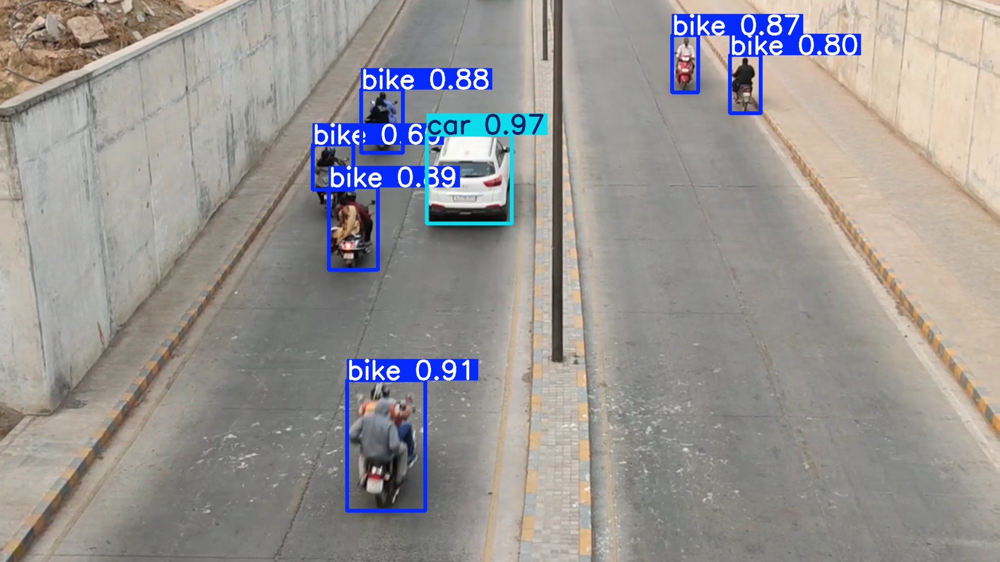

In [8]:
prediction= model('Dataset/images/val/img_150.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_151.png: 384x640 4 bikes, 1 car, 7.1ms
Speed: 2.4ms preprocess, 7.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 0., 0., 0., 0.], device='cuda:0')
conf: tensor([0.9525, 0.9202, 0.9170, 0.8993, 0.7568], device='cuda:0')
data: tensor([[1.1366e+03, 2.2358e+02, 1.3194e+03, 4.2503e+02, 9.5250e-01, 1.0000e+00],
        [1.3347e+03, 2.1992e+02, 1.4202e+03, 3.7904e+02, 9.2017e-01, 0.0000e+00],
        [6.7803e+02, 1.8991e+02, 7.5426e+02, 3.2268e+02, 9.1699e-01, 0.0000e+00],
        [1.5364e+03, 5.8023e+02, 1.6479e+03, 8.2493e+02, 8.9925e-01, 0.0000e+00],
        [1.2454e+03, 9.6648e+00, 1.3108e+03, 1.1794e+02, 7.5682e-01, 0.0000e+00]], device='cuda:0')
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([5, 6])
xywh: tensor([[1227.9624,  324.3066,  182.7825,  201.4463],
        [1377.4537,  299.4819,   85.5320,  159.

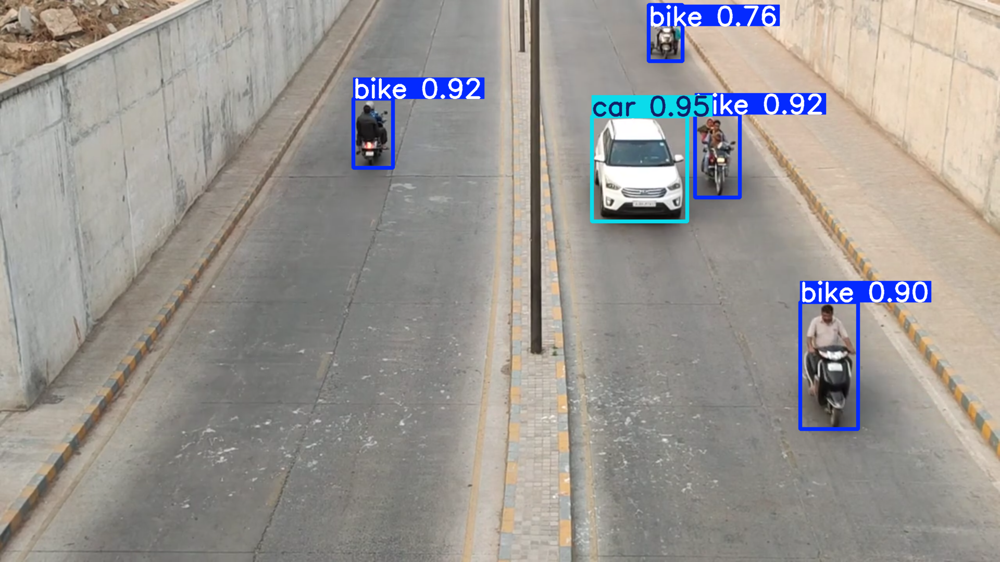

In [9]:
prediction= model('Dataset/images/val/img_151.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_108.png: 384x640 2 pedestrians, 13.2ms
Speed: 3.7ms preprocess, 13.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([2., 2.], device='cuda:0')
conf: tensor([0.9538, 0.9044], device='cuda:0')
data: tensor([[1.7547e+03, 2.2920e+02, 1.8132e+03, 3.8486e+02, 9.5384e-01, 2.0000e+00],
        [1.6781e+03, 2.3263e+02, 1.7305e+03, 3.8765e+02, 9.0444e-01, 2.0000e+00]], device='cuda:0')
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([2, 6])
xywh: tensor([[1783.9713,  307.0291,   58.4487,  155.6679],
        [1704.3030,  310.1421,   52.4930,  155.0217]], device='cuda:0')
xywhn: tensor([[0.9292, 0.2843, 0.0304, 0.1441],
        [0.8877, 0.2872, 0.0273, 0.1435]], device='cuda:0')
xyxy: tensor([[1754.7469,  229.1952, 1813.1957,  384.8630],
        [1678.0565,  232.6313, 1730.5496,  387.6530]], device='cuda:0')
xyxyn: tensor([

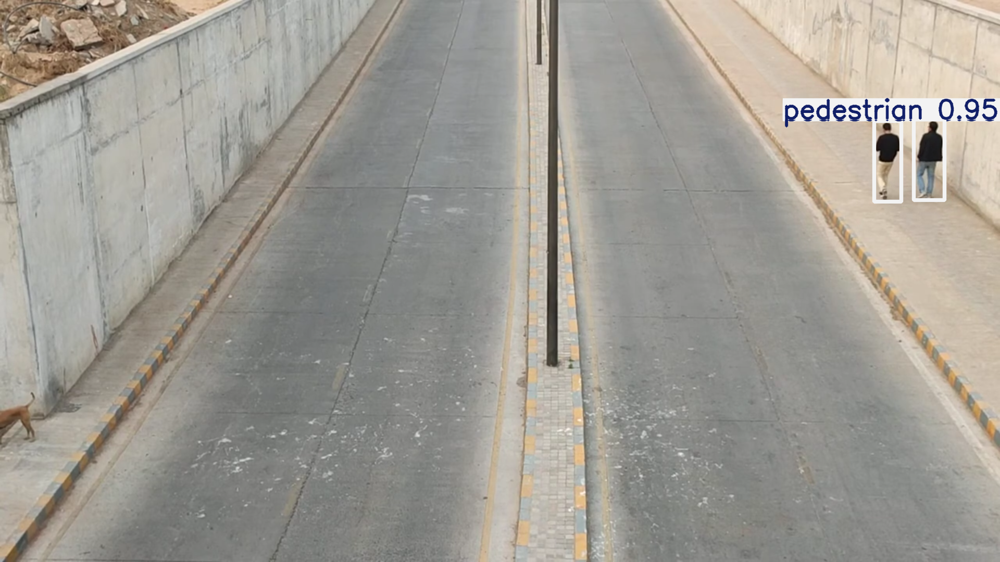

In [10]:
prediction= model('Dataset/images/val/img_108.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_134.png: 384x640 2 bikes, 1 car, 7.3ms
Speed: 2.5ms preprocess, 7.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 0., 0.], device='cuda:0')
conf: tensor([0.9516, 0.9118, 0.8551], device='cuda:0')
data: tensor([[1.1566e+03, 2.6877e+02, 1.3378e+03, 4.6756e+02, 9.5164e-01, 1.0000e+00],
        [1.5620e+03, 6.7466e+02, 1.7039e+03, 9.9043e+02, 9.1178e-01, 0.0000e+00],
        [1.2359e+03, 6.3692e+00, 1.2801e+03, 9.2936e+01, 8.5511e-01, 0.0000e+00]], device='cuda:0')
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([3, 6])
xywh: tensor([[1247.1808,  368.1661,  181.2102,  198.7851],
        [1632.9578,  832.5454,  141.8463,  315.7775],
        [1258.0208,   49.6527,   44.1444,   86.5669]], device='cuda:0')
xywhn: tensor([[0.6496, 0.3409, 0.0944, 0.1841],
        [0.8505, 0.7709, 0.0739, 0.2924],
        [0.6552, 0

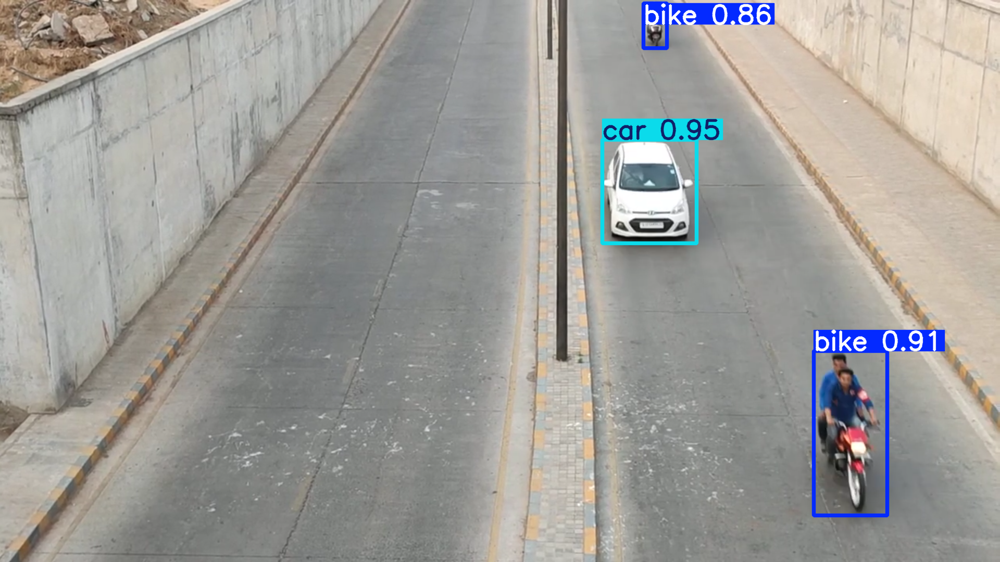

In [11]:
prediction= model('Dataset/images/val/img_134.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_145.png: 384x640 6 bikes, 1 car, 10.0ms
Speed: 3.1ms preprocess, 10.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([0., 1., 0., 0., 0., 0., 0.], device='cuda:0')
conf: tensor([0.9627, 0.9464, 0.9332, 0.8933, 0.8628, 0.8515, 0.8330], device='cuda:0')
data: tensor([[1.4997e+03, 4.8846e+02, 1.6090e+03, 7.0790e+02, 9.6266e-01, 0.0000e+00],
        [1.2227e+03, 4.3622e+02, 1.4415e+03, 6.9902e+02, 9.4641e-01, 1.0000e+00],
        [6.1543e+02, 6.7368e+02, 7.3232e+02, 9.0752e+02, 9.3321e-01, 0.0000e+00],
        [6.7051e+02, 1.8631e+02, 7.3635e+02, 3.0705e+02, 8.9327e-01, 0.0000e+00],
        [8.7592e+02, 2.9213e+01, 9.1983e+02, 1.2430e+02, 8.6278e-01, 0.0000e+00],
        [7.5661e+02, 1.4089e+01, 8.0098e+02, 1.0154e+02, 8.5155e-01, 0.0000e+00],
        [7.9483e+02, 2.0316e+02, 8.6140e+02, 3.3684e+02, 8.3299e-01, 0.0000e+00]], device='cu

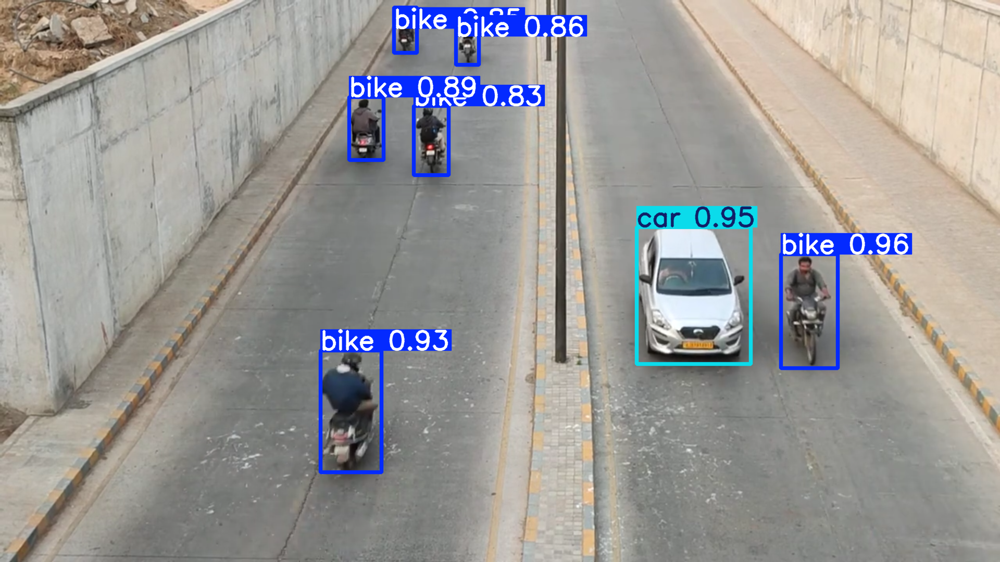

In [12]:
prediction= model('Dataset/images/val/img_145.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_144.png: 384x640 7 bikes, 1 car, 7.2ms
Speed: 2.5ms preprocess, 7.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 0., 0., 0., 0., 0., 0., 0.], device='cuda:0')
conf: tensor([0.9544, 0.9305, 0.9293, 0.9172, 0.9092, 0.8991, 0.8877, 0.8595], device='cuda:0')
data: tensor([[1.1323e+03, 2.2950e+01, 1.2324e+03, 1.2819e+02, 9.5438e-01, 1.0000e+00],
        [5.8864e+02, 7.3491e+02, 7.1151e+02, 9.7684e+02, 9.3052e-01, 0.0000e+00],
        [1.5012e+03, 7.6825e+02, 1.6439e+03, 1.0656e+03, 9.2930e-01, 0.0000e+00],
        [1.4240e+03, 2.0401e+02, 1.4938e+03, 3.4634e+02, 9.1717e-01, 0.0000e+00],
        [4.0895e+02, 5.1585e+02, 5.2658e+02, 7.0528e+02, 9.0915e-01, 0.0000e+00],
        [1.3191e+03, 2.1443e+02, 1.3986e+03, 3.7248e+02, 8.9913e-01, 0.0000e+00],
        [1.5213e+03, 4.0318e+02, 1.6136e+03, 5.8975e+02, 8.8774e-01, 0.0000e+00],
 

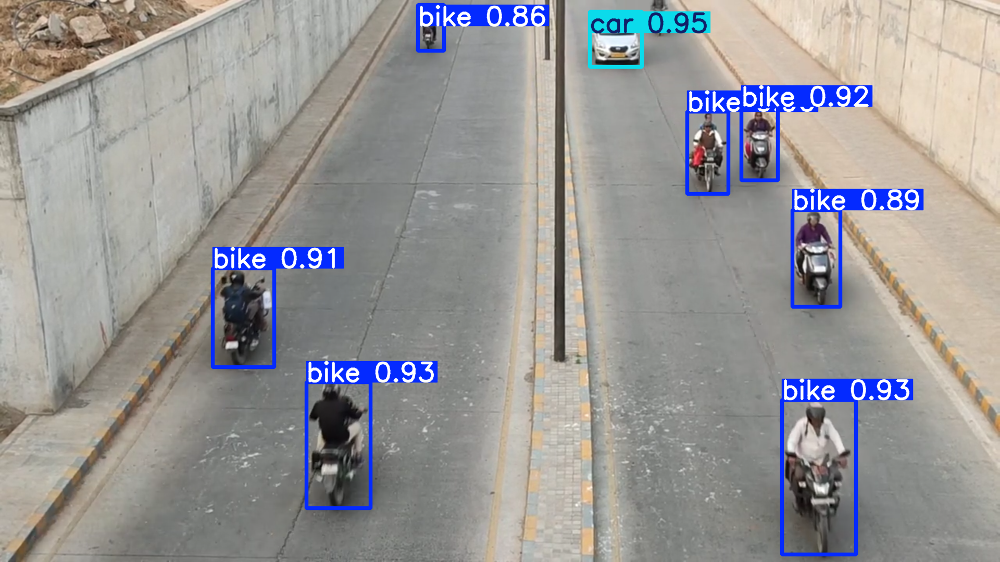

In [13]:
prediction= model('Dataset/images/val/img_144.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_135.png: 384x640 5 bikes, 1 car, 7.0ms
Speed: 2.4ms preprocess, 7.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([0., 1., 0., 0., 0., 0.], device='cuda:0')
conf: tensor([0.9370, 0.9332, 0.9141, 0.8922, 0.8921, 0.7382], device='cuda:0')
data: tensor([[6.4593e+02, 3.6447e+02, 7.3003e+02, 5.2664e+02, 9.3704e-01, 0.0000e+00],
        [1.1884e+03, 3.3153e+02, 1.4161e+03, 6.2697e+02, 9.3320e-01, 1.0000e+00],
        [1.4587e+03, 3.1590e+02, 1.5507e+03, 4.9350e+02, 9.1407e-01, 0.0000e+00],
        [4.7722e+02, 4.7417e+02, 5.7217e+02, 6.4975e+02, 8.9224e-01, 0.0000e+00],
        [1.2918e+03, 1.2664e+02, 1.3580e+03, 2.6263e+02, 8.9210e-01, 0.0000e+00],
        [1.2600e+03, 2.8537e+01, 1.3148e+03, 1.3608e+02, 7.3817e-01, 0.0000e+00]], device='cuda:0')
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([6, 6])
xywh: tensor(

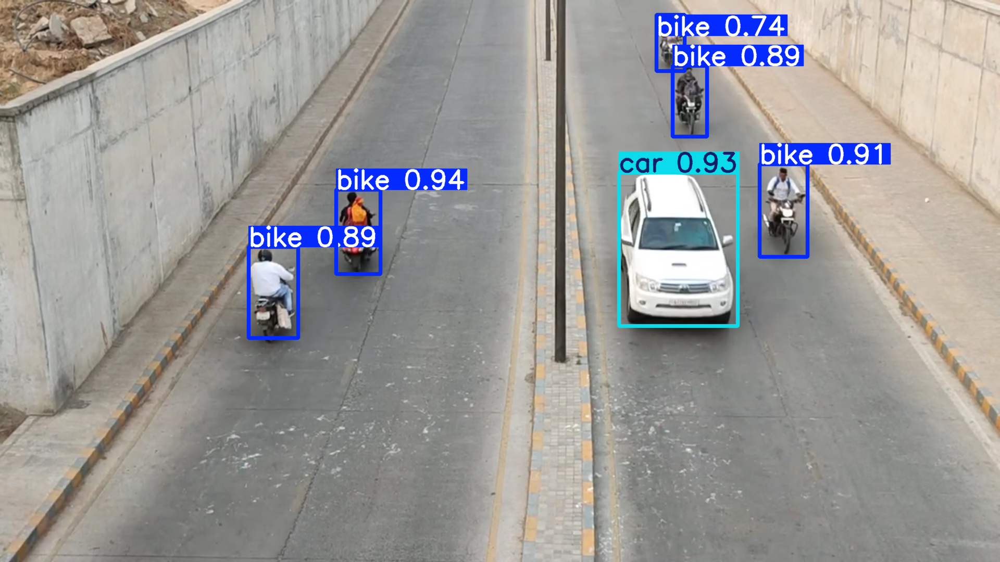

In [14]:
prediction= model('Dataset/images/val/img_135.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_110.png: 384x640 1 bike, 1 car, 2 pedestrians, 12.3ms
Speed: 5.1ms preprocess, 12.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([2., 1., 2., 0.], device='cuda:0')
conf: tensor([0.9539, 0.9400, 0.8698, 0.8429], device='cuda:0')
data: tensor([[1.5105e+03, 1.1774e+02, 1.5601e+03, 2.4460e+02, 9.5393e-01, 2.0000e+00],
        [7.4069e+02, 1.4570e+02, 8.8161e+02, 2.8281e+02, 9.4003e-01, 1.0000e+00],
        [1.5841e+03, 1.1517e+02, 1.6381e+03, 2.4113e+02, 8.6985e-01, 2.0000e+00],
        [1.2842e+03, 6.4657e+01, 1.3367e+03, 1.7187e+02, 8.4285e-01, 0.0000e+00]], device='cuda:0')
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([4, 6])
xywh: tensor([[1535.3406,  181.1687,   49.5861,  126.8668],
        [ 811.1528,  214.2537,  140.9162,  137.1114],
        [1611.1045,  178.1516,   54.0751,  125.9618],
        [1310.413

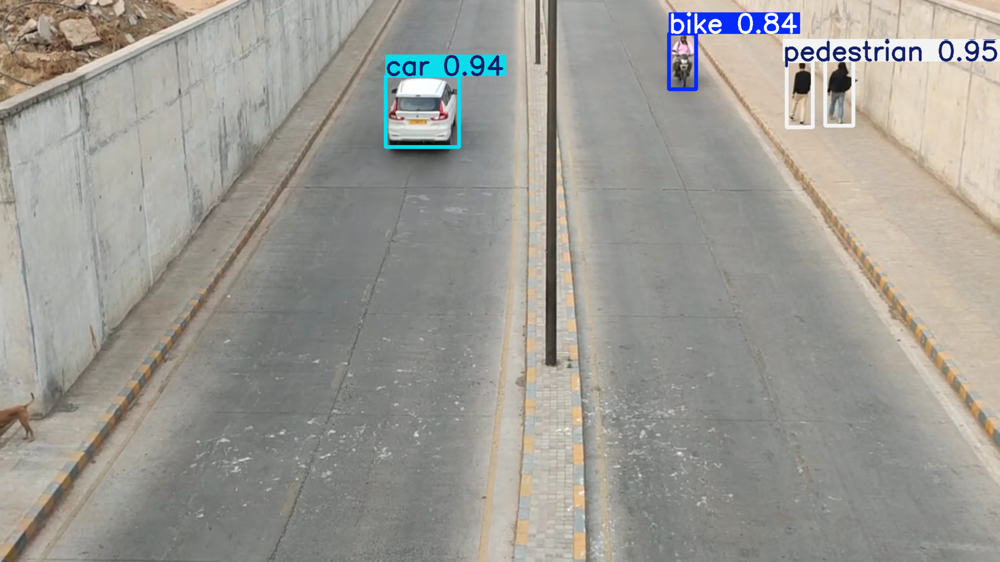

In [15]:
prediction= model('Dataset/images/val/img_110.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_60.png: 384x640 4 bikes, 1 car, 1 pedestrian, 6.9ms
Speed: 2.4ms preprocess, 6.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([1., 0., 0., 0., 2., 0.], device='cuda:0')
conf: tensor([0.9676, 0.9575, 0.9081, 0.8858, 0.8683, 0.8364], device='cuda:0')
data: tensor([[1.1728e+03, 2.0455e+02, 1.3302e+03, 3.6010e+02, 9.6763e-01, 1.0000e+00],
        [1.4550e+03, 8.0577e+02, 1.5915e+03, 1.0709e+03, 9.5747e-01, 0.0000e+00],
        [8.0186e+02, 2.4517e+02, 8.8192e+02, 3.8304e+02, 9.0809e-01, 0.0000e+00],
        [1.2252e+03, 2.3822e+01, 1.2710e+03, 1.1694e+02, 8.8584e-01, 0.0000e+00],
        [2.6396e+02, 4.5559e+02, 3.4356e+02, 6.3087e+02, 8.6829e-01, 2.0000e+00],
        [1.2994e+03, 1.0769e+02, 1.3596e+03, 2.2457e+02, 8.3641e-01, 0.0000e+00]], device='cuda:0')
id: None
is_track: False
orig_shape: (1080, 1920)
shape: torch.Size([6, 6])


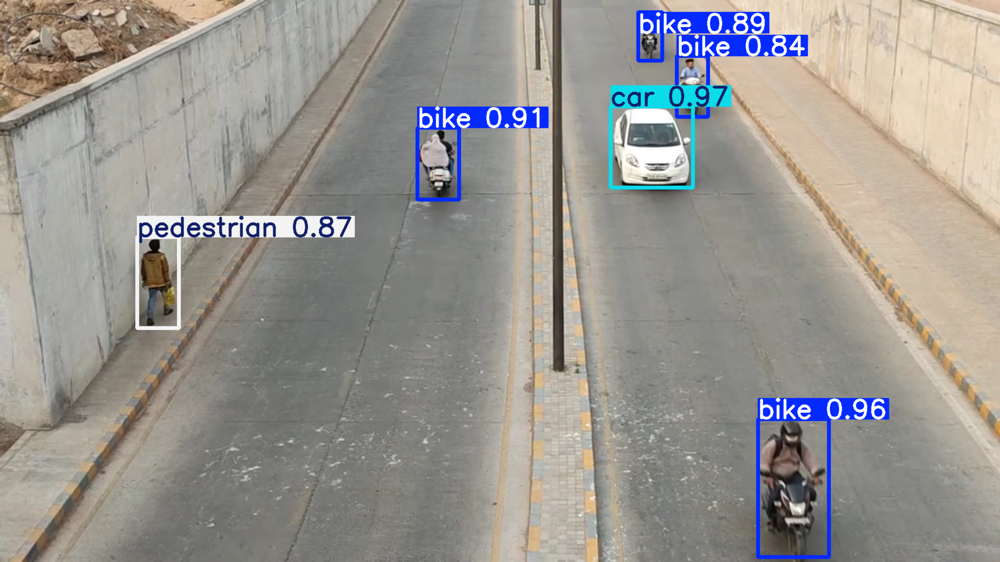

In [16]:
prediction= model('Dataset/images/val/img_60.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()



image 1/1 /content/drive/MyDrive/Bondstein/Dataset/images/val/img_34.png: 384x640 5 bikes, 2 pedestrians, 7.1ms
Speed: 2.4ms preprocess, 7.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
ultralytics.engine.results.Boxes object with attributes:

cls: tensor([2., 2., 0., 0., 0., 0., 0.], device='cuda:0')
conf: tensor([0.9820, 0.9257, 0.9166, 0.9126, 0.8765, 0.8280, 0.7937], device='cuda:0')
data: tensor([[4.3430e+02, 2.7394e+02, 4.8206e+02, 4.2205e+02, 9.8200e-01, 2.0000e+00],
        [4.8019e+02, 2.5652e+02, 5.2711e+02, 3.9899e+02, 9.2568e-01, 2.0000e+00],
        [1.4195e+03, 3.5437e+02, 1.5045e+03, 5.3485e+02, 9.1657e-01, 0.0000e+00],
        [1.5775e+03, 6.5425e+02, 1.7047e+03, 9.0913e+02, 9.1262e-01, 0.0000e+00],
        [1.2725e+03, 1.0747e+02, 1.3259e+03, 2.2102e+02, 8.7650e-01, 0.0000e+00],
        [1.1659e+03, 8.1755e+01, 1.2141e+03, 1.8714e+02, 8.2804e-01, 0.0000e+00],
        [7.2424e+02, 4.3999e+01, 7.7126e+02, 1.3284e+02, 7.9368e-01, 0.0000e+00]], devic

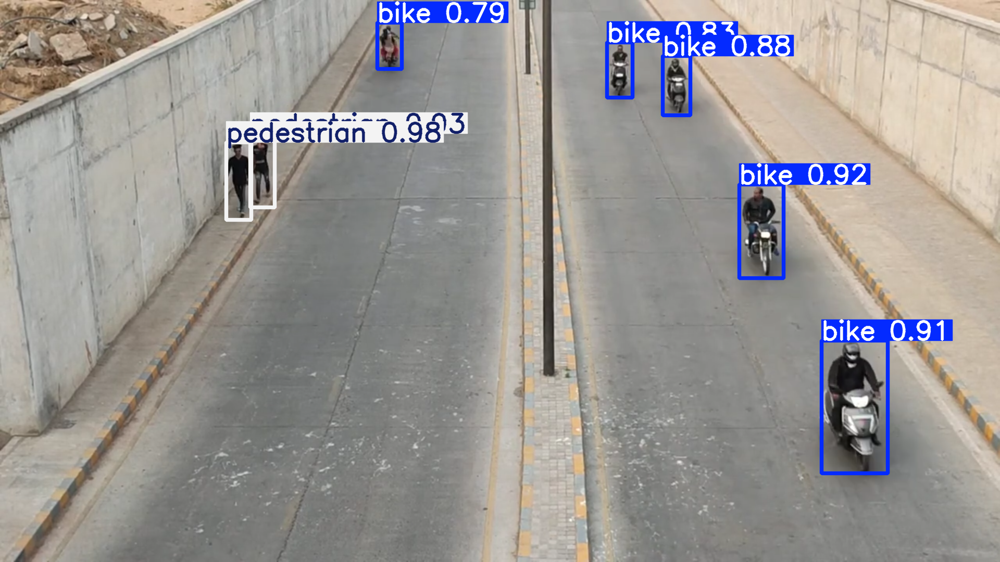

In [17]:
prediction= model('Dataset/images/val/img_34.png')
for pred in prediction:
  print(pred.boxes)
  pred.show()


In [18]:
# Show the metrics on validation data
metrics = model.val()

Ultralytics 8.3.71 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/drive/.shortcut-targets-by-id/1ssI0mo9gAtWxW2SBTpMNlG7opQnFbFDh/Bondstein/Dataset/labels/val.cache... 32 images, 0 backgrounds, 0 corrupt: 100%|██████████| 32/32 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.22s/it]


                   all         32        156       0.95      0.994      0.981      0.696
                  bike         30        108      0.973      0.983      0.988      0.641
                   car         29         36      0.968          1      0.992      0.782
            pedestrian          7         12      0.909          1      0.963      0.667
Speed: 0.2ms preprocess, 6.5ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/detect/val
